<a href="https://colab.research.google.com/github/sertuxito/Data-Cience-II/blob/main/DataCiensceII_NYPD_Shooting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Abstract
##Titulo
"Analisis de Intervenciones de la Policia de Nueva York donde se genera un intercambio de tiros"

##Hipótesis

 Se trata de buscar relacion entre las ubicaciones de los incidentes donde el tiroteo termina en muerte.



In [ ]:
!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt

Cargo libreria de geopandas para que se puedan interpretar las geolocalizaciones.


In [ ]:
import pandas as pd
import numpy as np

In [ ]:

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [ ]:
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)


In [ ]:
df.describe()

,INCIDENT_KEY,PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,2.856200e+04,28562.000000,28560.000000,2.856200e+04,28562.000000,28503.000000,28503.000000
mean,1.274058e+08,65.496009,0.321884,1.009424e+06,208380.075755,40.738570,-73.909099
std,7.804340e+07,27.342643,0.733035,1.830111e+04,31917.509528,0.087611,0.065967
min,9.953245e+06,1.000000,0.000000,9.149281e+05,125756.718750,40.511586,-74.249303
25%,6.543991e+07,44.000000,0.000000,1.000068e+06,182912.000000,40.668648,-73.942917
50%,9.271125e+07,67.000000,0.000000,1.007772e+06,194901.390625,40.701467,-73.915068
75%,2.031320e+08,81.000000,0.000000,1.016807e+06,239814.234375,40.824878,-73.882366
max,2.797581e+08,123.000000,2.000000,1.066815e+06,271127.687500,40.910818,-73.702046


In [ ]:
df.duplicated().sum()

0

In [8]:
print("Primeras filas del dataset:")
display(df.head())

# INFORMACIÓN GENERAL DEL DATASET
print("\nInformación general del dataset:")
df.info()

print("\nEstadísticas descriptivas:")
display(df.describe(include='all'))

# COMPROBACIÓN DE VALORES NULOS
print("\nCantidad de valores nulos por columna:")
display(df.isnull().sum())

Primeras filas del dataset:


,Latitude,Longitude,STATISTICAL_MURDER_FLAG,dist_min_fatalShooting
0,40.754692,-73.993500,True,0.001901
1,40.854402,-73.882330,True,0.000904
2,40.710634,-73.767773,False,0.001157
3,40.832417,-73.890714,False,0.001033
4,40.688443,-73.910219,False,0.001729



Información general del dataset:
<class 'pandas.core.frame.DataFrame'>
Index: 28503 entries, 0 to 28561
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Latitude                 28503 non-null  float64
 1   Longitude                28503 non-null  float64
 2   STATISTICAL_MURDER_FLAG  28503 non-null  bool   
 3   dist_min_fatalShooting   28503 non-null  float64
dtypes: bool(1), float64(3)
memory usage: 918.6 KB

Estadísticas descriptivas:


,Latitude,Longitude,STATISTICAL_MURDER_FLAG,dist_min_fatalShooting
count,28503.000000,28503.000000,28503,2.850300e+04
unique,NaN,NaN,2,NaN
top,NaN,NaN,False,NaN
freq,NaN,NaN,22981,NaN
mean,40.738570,-73.909099,NaN,1.363224e-03
std,0.087611,0.065967,NaN,1.602443e-03
min,40.511586,-74.249303,NaN,7.105427e-15
25%,40.668648,-73.942917,NaN,6.483065e-04
50%,40.701467,-73.915068,NaN,9.945920e-04
75%,40.824878,-73.882366,NaN,1.588752e-03



Cantidad de valores nulos por columna:


,0
Latitude,0
Longitude,0
STATISTICAL_MURDER_FLAG,0
dist_min_fatalShooting,0


In [9]:
from shapely.geometry import Point
import matplotlib.pyplot as plt

In [10]:

!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import folium

# Supongamos que tienes un DataFrame con las columnas 'latitude', 'longitude' y 'accident'


In [11]:
# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude']]
y = df['STATISTICAL_MURDER_FLAG']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [12]:
# Crear un modelo de Ramdom Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.82      0.91      0.86      4617
        True       0.30      0.16      0.21      1084

    accuracy                           0.77      5701
   macro avg       0.56      0.54      0.54      5701
weighted avg       0.72      0.77      0.74      5701

[[4208  409]
 [ 908  176]]


In [13]:
# Crear un mapa centrado en una ubicación específica
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)

for idx, row in df.iterrows():
    color = 'red' if row['STATISTICAL_MURDER_FLAG'] else 'green'
    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)

m

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix



# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude']]
y = df['STATISTICAL_MURDER_FLAG']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Crear un modelo de regresión logística
model = LogisticRegression()

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.81      1.00      0.89      4617
        True       0.00      0.00      0.00      1084

    accuracy                           0.81      5701
   macro avg       0.40      0.50      0.45      5701
weighted avg       0.66      0.81      0.72      5701

[[4617    0]
 [1084    0]]


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude']]
y = df['STATISTICAL_MURDER_FLAG'].astype(int)  # Convertir booleanos a enteros (0 y 1)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Crear un modelo de regresión lineal
model = LinearRegression()

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

# Mostrar los coeficientes del modelo
print("Coeficientes del modelo:", model.coef_)
print("Intercepto del modelo:", model.intercept_)

Mean Squared Error: 0.15401559712752588
R^2 Score: -0.00017876388482629402
Coeficientes del modelo: [-0.01936487  0.02832306]
Intercepto del modelo: 3.0768613661333886


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
file_path = '/content/drive/MyDrive/Data ScienceII/NYPD_Shooting_Incident_Data__Historic_.csv'
df = pd.read_csv(file_path)


# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG', 'OCCUR_TIME']].dropna()

# Convertir la columna 'OCCUR_TIME' a una variable numérica (por ejemplo, minutos desde la medianoche)
df['Tiempo de ocurrencia'] = df['OCCUR_TIME'].apply(lambda x: int(x.split(':')[0]) * 60 + int(x.split(':')[1]))

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude', 'Tiempo de ocurrencia']]
y = df['STATISTICAL_MURDER_FLAG'].astype(int)  # Convertir booleanos a enteros (0 y 1)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Crear un modelo de regresión lineal
model = LinearRegression()

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

# Mostrar los coeficientes del modelo
print("Coeficientes del modelo:", model.coef_)
print("Intercepto del modelo:", model.intercept_)

Mean Squared Error: 0.15402624924306965
R^2 Score: -0.00024793882526097377
Coeficientes del modelo: [-1.91824120e-02  2.86727669e-02  5.26996134e-06]
Intercepto del modelo: 3.091243134756416


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix

file_path = '/content/drive/MyDrive/Data ScienceII/NYPD_Shooting_Incident_Data__Historic_.csv'
df = pd.read_csv(file_path)

# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG', 'OCCUR_TIME']].dropna()

# Convertir la columna 'OCCUR_TIME' a una variable numérica (por ejemplo, minutos desde la medianoche)
df['Tiempo de ocurrencia'] = df['OCCUR_TIME'].apply(lambda x: int(x.split(':')[0]) * 60 + int(x.split(':')[1]))

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude', 'Tiempo de ocurrencia']]
y = df['STATISTICAL_MURDER_FLAG'].astype(int)  # Convertir booleanos a enteros (0 y 1)



In [ ]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Función para entrenar y evaluar un modelo
def train_and_evaluate_model(model):
    # Entrenar el modelo
    model.fit(X_train, y_train)

    # Hacer predicciones
    y_pred = model.predict(X_test)

    # Evaluar el modelo
    print(f"Modelo: {model.__class__.__name__}")
    print(classification_report(y_test, y_pred))
    print(confusion_matrix(y_test, y_pred))
    print("\n")



In [ ]:
# Aplicar Árboles de Decisión
decision_tree_model = DecisionTreeClassifier(random_state=42)
train_and_evaluate_model(decision_tree_model)



Modelo: DecisionTreeClassifier
              precision    recall  f1-score   support

           0       0.82      0.82      0.82      4617
           1       0.24      0.24      0.24      1084

    accuracy                           0.71      5701
   macro avg       0.53      0.53      0.53      5701
weighted avg       0.71      0.71      0.71      5701

[[3796  821]
 [ 823  261]]




In [ ]:
# Aplicar Bosques Aleatorios
random_forest_model = RandomForestClassifier(n_estimators=100, random_state=42)
train_and_evaluate_model(random_forest_model)



Modelo: RandomForestClassifier
              precision    recall  f1-score   support

           0       0.83      0.94      0.88      4617
           1       0.38      0.17      0.23      1084

    accuracy                           0.79      5701
   macro avg       0.60      0.55      0.56      5701
weighted avg       0.74      0.79      0.76      5701

[[4320  297]
 [ 901  183]]




In [ ]:
# Aplicar Máquinas de Soporte Vectorial (SVM)
svm_model = SVC(kernel='linear', random_state=42)
train_and_evaluate_model(svm_model)


Modelo: SVC
              precision    recall  f1-score   support

           0       0.81      0.94      0.87      4617
           1       0.16      0.05      0.07      1084

    accuracy                           0.77      5701
   macro avg       0.48      0.49      0.47      5701
weighted avg       0.69      0.77      0.72      5701

[[4351  266]
 [1033   51]]




In [ ]:

# Aplicar Redes Neuronales
neural_network_model = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=42)
train_and_evaluate_model(neural_network_model)



Modelo: MLPClassifier
              precision    recall  f1-score   support

           0       0.81      1.00      0.89      4617
           1       0.00      0.00      0.00      1084

    accuracy                           0.81      5701
   macro avg       0.40      0.50      0.45      5701
weighted avg       0.66      0.81      0.72      5701

[[4617    0]
 [1084    0]]




/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
# Aplicar Gradient Boosting
gradient_boosting_model = GradientBoostingClassifier(n_estimators=100, random_state=42)
train_and_evaluate_model(gradient_boosting_model)

Modelo: GradientBoostingClassifier
              precision    recall  f1-score   support

           0       0.81      1.00      0.90      4617
           1       1.00      0.00      0.00      1084

    accuracy                           0.81      5701
   macro avg       0.91      0.50      0.45      5701
weighted avg       0.85      0.81      0.73      5701

[[4617    0]
 [1082    2]]




In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

file_path = '/content/drive/MyDrive/Data ScienceII/NYPD_Shooting_Incident_Data__Historic_.csv'
df = pd.read_csv(file_path)


# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG', 'OCCUR_TIME']].dropna()

# Convertir la columna 'OCCUR_TIME' a una variable numérica (por ejemplo, minutos desde la medianoche)
df['Tiempo de ocurrencia'] = df['OCCUR_TIME'].apply(lambda x: int(x.split(':')[0]) * 60 + int(x.split(':')[1]))

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude', 'Tiempo de ocurrencia']]
y = df['STATISTICAL_MURDER_FLAG'].astype(int)  # Convertir booleanos a enteros (0 y 1)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Sobremuestreo de la clase minoritaria usando SMOTE
smote = SMOTE(random_state=42)
X_resampled_smote, y_resampled_smote = smote.fit_resample(X_train, y_train)

# Submuestreo de la clase mayoritaria usando RandomUnderSampler
undersample = RandomUnderSampler(random_state=42)
X_resampled_under, y_resampled_under = undersample.fit_resample(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/utils/_tags.py:354: FutureWarning: The SMOTE or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.valida

In [ ]:
# Crear un modelo de bosque aleatorio
model = RandomForestClassifier(n_estimators=100, random_state=42)

# Entrenar y evaluar el modelo con sobremuestreo (SMOTE)
model.fit(X_resampled_smote, y_resampled_smote)
y_pred_smote = model.predict(X_test)
accuracy_smote = accuracy_score(y_test, y_pred_smote)

print("Resultados con SMOTE (Sobremuestreo):")
print(classification_report(y_test, y_pred_smote))
print(confusion_matrix(y_test, y_pred_smote))

Resultados con SMOTE (Sobremuestreo):
              precision    recall  f1-score   support

           0       0.84      0.75      0.79      4617
           1       0.27      0.40      0.32      1084

    accuracy                           0.69      5701
   macro avg       0.56      0.58      0.56      5701
weighted avg       0.73      0.69      0.71      5701

[[3475 1142]
 [ 653  431]]


In [ ]:
# Entrenar y evaluar el modelo con submuestreo (RandomUnderSampler)
model.fit(X_resampled_under, y_resampled_under)
y_pred_under = model.predict(X_test)
accuracy_under = accuracy_score(y_test, y_pred_under)

print("Resultados con RandomUnderSampler (Submuestreo):")
print(classification_report(y_test, y_pred_under))
print(confusion_matrix(y_test, y_pred_under))

Resultados con RandomUnderSampler (Submuestreo):
              precision    recall  f1-score   support

           0       0.86      0.57      0.69      4617
           1       0.25      0.60      0.35      1084

    accuracy                           0.58      5701
   macro avg       0.55      0.59      0.52      5701
weighted avg       0.74      0.58      0.62      5701

[[2652 1965]
 [ 434  650]]


In [ ]:
# Ajustar hiperparámetros del modelo usando GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)
grid_search.fit(X_resampled_smote, y_resampled_smote)

best_model = grid_search.best_estimator_
y_pred_best = best_model.predict(X_test)
accuracy_best = accuracy_score(y_test, y_pred_best)

print("Mejores hiperparámetros encontrados por GridSearchCV:")
print(grid_search.best_params_)
print("Resultados con los mejores hiperparámetros:")
print(classification_report(y_test, y_pred_best))
print(confusion_matrix(y_test, y_pred_best))

Fitting 3 folds for each of 81 candidates, totalling 243 fits
Mejores hiperparámetros encontrados por GridSearchCV:
{'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Resultados con los mejores hiperparámetros:
              precision    recall  f1-score   support

           0       0.84      0.75      0.80      4617
           1       0.27      0.39      0.32      1084

    accuracy                           0.69      5701
   macro avg       0.56      0.57      0.56      5701
weighted avg       0.73      0.69      0.71      5701

[[3481 1136]
 [ 657  427]]


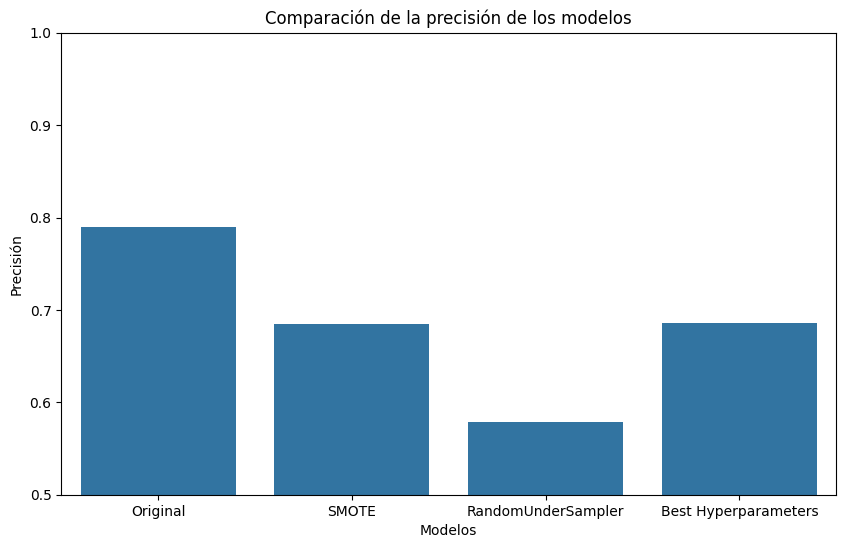

In [ ]:
# Gráficos comparativos de los distintos modelos
models = ['Original', 'SMOTE', 'RandomUnderSampler', 'Best Hyperparameters']
accuracies = [0.79, accuracy_smote, accuracy_under, accuracy_best]

plt.figure(figsize=(10, 6))
sns.barplot(x=models, y=accuracies)
plt.title('Comparación de la precisión de los modelos')
plt.xlabel('Modelos')
plt.ylabel('Precisión')
plt.ylim(0.5, 1.0)
plt.show()

<ipython-input-62-a0715faaff5d>:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Modelo", y="Precision_0", data=df_results, palette="viridis")
<ipython-input-62-a0715faaff5d>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Modelo", y="Precision_1", data=df_results, palette="viridis")


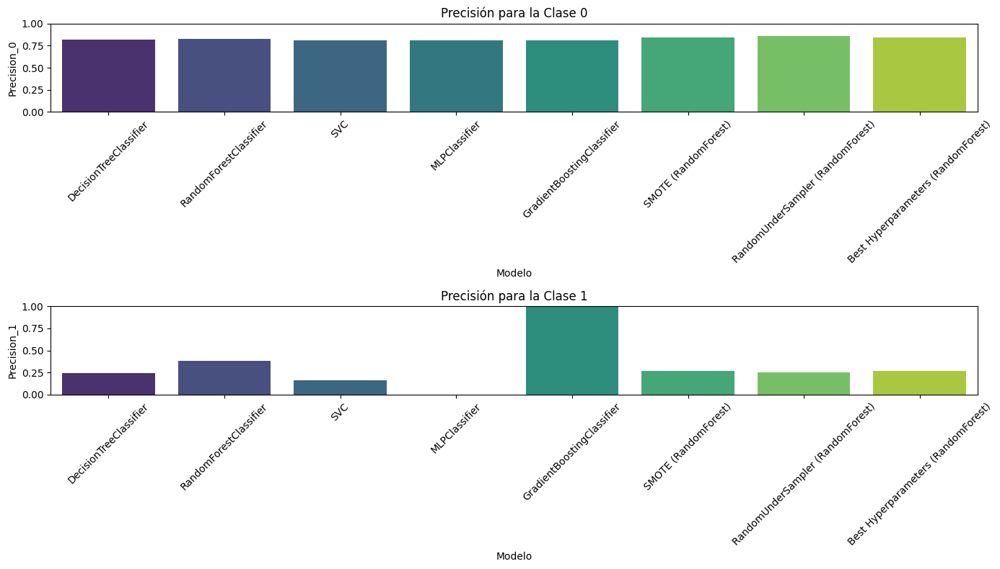

In [ ]:
# Resultados de los modelos
results = {
    "Modelo": ["DecisionTreeClassifier", "RandomForestClassifier", "SVC", "MLPClassifier", "GradientBoostingClassifier", "SMOTE (RandomForest)", "RandomUnderSampler (RandomForest)", "Best Hyperparameters (RandomForest)"],
    "Precision_0": [0.82, 0.83, 0.81, 0.81, 0.81, 0.84, 0.86, 0.84],
    "Recall_0": [0.82, 0.94, 0.94, 1.00, 1.00, 0.75, 0.57, 0.75],
    "F1-Score_0": [0.82, 0.88, 0.87, 0.89, 0.90, 0.79, 0.69, 0.80],
    "Precision_1": [0.24, 0.38, 0.16, 0.00, 1.00, 0.27, 0.25, 0.27],
    "Recall_1": [0.24, 0.17, 0.05, 0.00, 0.00, 0.40, 0.60, 0.39],
    "F1-Score_1": [0.24, 0.23, 0.07, 0.00, 0.00, 0.32, 0.35, 0.32],
    "Accuracy": [0.71, 0.79, 0.77, 0.81, 0.81, 0.69, 0.58, 0.69],
    "Macro Avg Precision": [0.53, 0.60, 0.48, 0.40, 0.91, 0.56, 0.55, 0.56],
    "Macro Avg Recall": [0.53, 0.55, 0.49, 0.50, 0.50, 0.58, 0.59, 0.57],
    "Macro Avg F1-Score": [0.53, 0.56, 0.47, 0.45, 0.45, 0.56, 0.52, 0.56],
    "Weighted Avg Precision": [0.71, 0.74, 0.69, 0.66, 0.85, 0.73, 0.74, 0.73],
    "Weighted Avg Recall": [0.71, 0.79, 0.77, 0.81, 0.81, 0.69, 0.58, 0.69],
    "Weighted Avg F1-Score": [0.71, 0.76, 0.72, 0.72, 0.73, 0.71, 0.62, 0.71]
}

# Crear un DataFrame con los resultados
df_results = pd.DataFrame(results)

# Graficar los resultados
plt.figure(figsize=(14, 8))

# Gráfico para la clase 0
plt.subplot(2, 1, 1)
sns.barplot(x="Modelo", y="Precision_0", data=df_results, palette="viridis")
plt.title('Precisión para la Clase 0')
plt.xticks(rotation=45)
plt.ylim(0, 1)

# Gráfico para la clase 1
plt.subplot(2, 1, 2)
sns.barplot(x="Modelo", y="Precision_1", data=df_results, palette="viridis")
plt.title('Precisión para la Clase 1')
plt.xticks(rotation=45)
plt.ylim(0, 1)

plt.tight_layout()
plt.show()

# Otro Enfoque
##Distacias entre las posciciones
Intentare otro enfoque penando en la distancia de las coordenadas entre si....
vuelvo a cargar el dataset original

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns  # Importa la librería Seaborn para visualización de datos

In [2]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [3]:
# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

In [4]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from scipy.spatial import distance_matrix


#  Genero una matriz de distancias entre las coordenadas del dataset
coords = df[['Latitude', 'Longitude']].to_numpy()
dist_matrix = distance_matrix(coords, coords)



In [5]:
# Características basadas en distancia

df['dist_min_fatalShooting'] = [
    min(dist_matrix[i][df['STATISTICAL_MURDER_FLAG']][dist_matrix[i][df['STATISTICAL_MURDER_FLAG'] ] > 0])
    if any(df['STATISTICAL_MURDER_FLAG'] ) else np.inf
    for i in range(len(df))
]

df

,Latitude,Longitude,STATISTICAL_MURDER_FLAG,dist_min_fatalShooting
0,40.754692,-73.993500,True,0.001901
1,40.854402,-73.882330,True,0.000904
2,40.710634,-73.767773,False,0.001157
3,40.832417,-73.890714,False,0.001033
4,40.688443,-73.910219,False,0.001729
...,...,...,...,...
28557,40.903785,-73.850098,True,0.000008
28558,40.825549,-73.890195,False,0.000014
28559,40.821404,-73.898938,True,0.001559
28560,40.695717,-73.839138,False,0.000896


In [6]:
# Dividir en datos de entrenamiento y prueba
X = df[['dist_min_fatalShooting']]
y = df['STATISTICAL_MURDER_FLAG']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar un modelo de clasificación
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")

Accuracy: 0.77


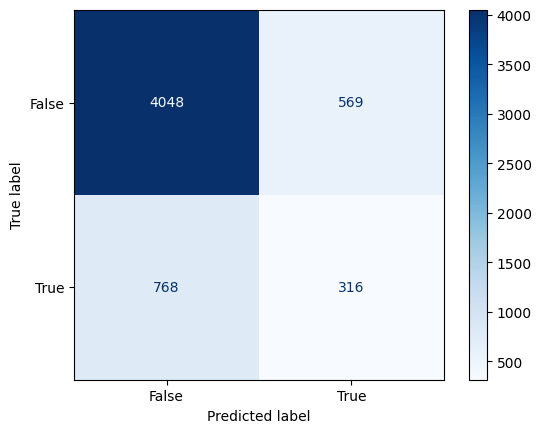

In [7]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Calcular la matriz de confusión
cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()

Canbiando de endoque buscando agrupar geolocalizaciones propensas a muertes fatales en un shooting con NYPD

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [7]:
# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

<ipython-input-21-1add58ef30eb>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_murder['cluster'] = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])


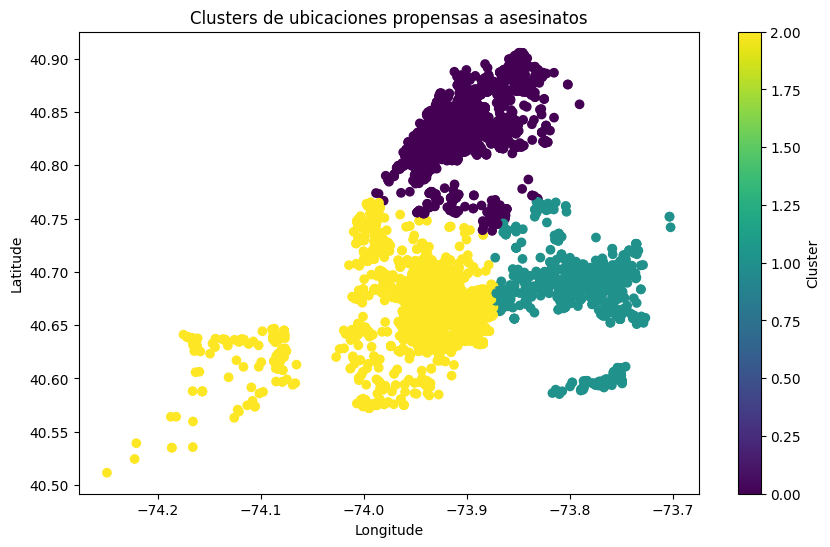

In [21]:


# Filtrar solo las ubicaciones con murderFlag True
df_murder = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_murder['cluster'] = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

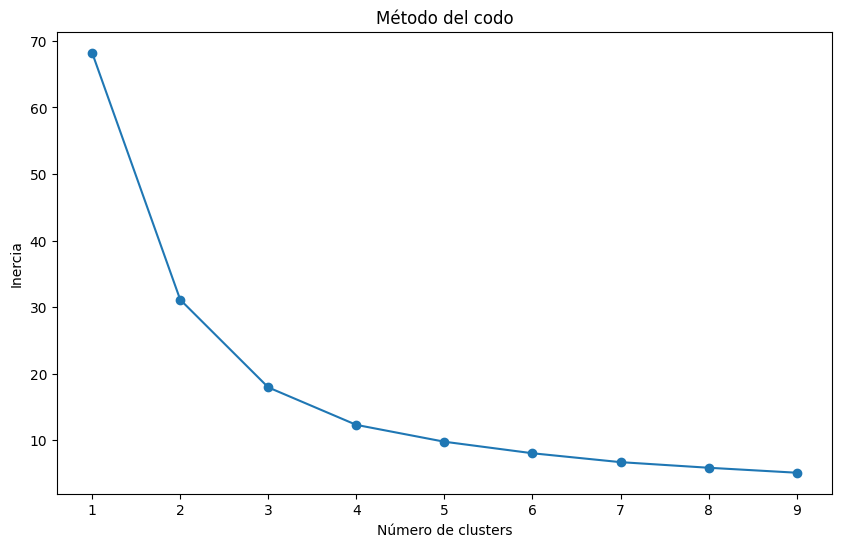

In [18]:
# Calcular la inercia para diferentes números de clusters
inercia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_murder[['Latitude', 'Longitude']])
    inercia.append(kmeans.inertia_)

# Graficar la inercia
plt.figure(figsize=(10, 6))
plt.plot(range(1, 10), inercia, marker='o') # Changed this line
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.title('Método del codo')
plt.show()

Segun la interpretacion del medodo del codo .. la cantidad de klusters apropiada para mi data set son 3

In [28]:
from sklearn.metrics import silhouette_score

# Calcular el coeficiente de silueta
kmeans = KMeans(n_clusters=3, random_state=42)
labels = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])
silhouette_avg = silhouette_score(df_murder[['Latitude', 'Longitude']], labels)

print(f"Coeficiente de Silueta: {silhouette_avg:.2f}")

Coeficiente de Silueta: 0.59


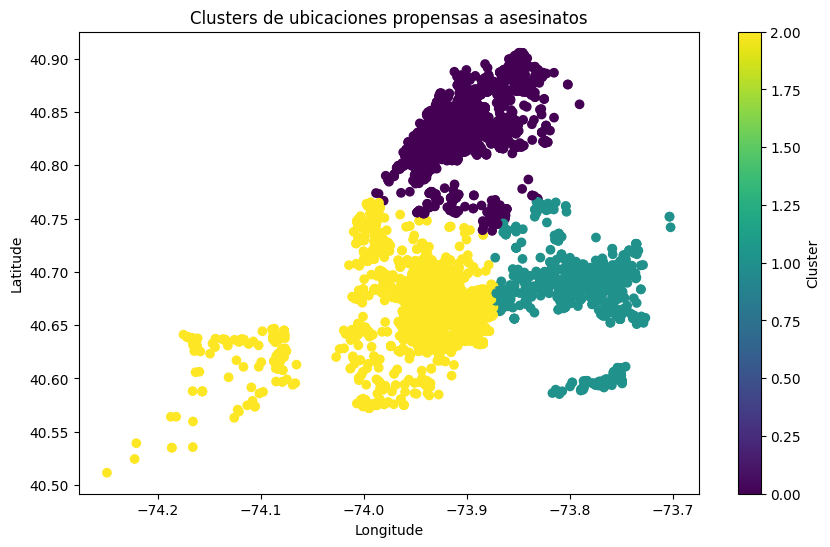

In [29]:
# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [35]:
df_murder


,Latitude,Longitude,STATISTICAL_MURDER_FLAG,cluster
0,40.754692,-73.993500,True,2
1,40.854402,-73.882330,True,0
6,40.673306,-73.789887,True,1
9,40.860463,-73.865561,True,0
11,40.769744,-73.909872,True,0
...,...,...,...,...
28544,40.634916,-73.932963,True,2
28549,40.700826,-73.881490,True,2
28551,40.695772,-73.979528,True,2
28557,40.903785,-73.850098,True,0


De esta manera puedo ubicar en el mapa de nueva york los 3 klusters

In [42]:

!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd

import folium
# Crear un mapa centrado en una ubicación específica
m = folium.Map(location=[df_murder['Latitude'].mean(), df_murder['Longitude'].mean()], zoom_start=12)

for idx, row in df_murder.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m